# Final Project

### Library Import

In [8]:
import pandas as pd
import numpy as np
import plotly.offline as py
import plotly
plotly.offline.init_notebook_mode()
plotly.tools.set_credentials_file(username='stfox13', api_key='Y4QUZyKzXSz7t8P209HF')
from plotly import *
from plotly.graph_objs import *
pd.options.display.float_format = '{0:.2f}'.format
import plotly.graph_objs as go
import cufflinks as cf
from sklearn import preprocessing
import lxml.etree as ET
import os
import geopy.distance
import seaborn as sns; sns.set(style="ticks", color_codes=True)
import matplotlib.pyplot as plt
from sklearn.cross_validation import train_test_split
from sklearn import linear_model
import statsmodels.api as sm
import statsmodels.formula.api as smf
from statsmodels.formula.api import ols
from sklearn.ensemble import RandomForestClassifier
from sklearn import cross_validation
from sklearn.linear_model import LinearRegression
import matplotlib.cm as cm

%matplotlib inline
mapbox_access_token='pk.eyJ1Ijoic3Rmb3gxMyIsImEiOiJjajJnejd6M2cwMDVmMnlsZ3I4aGI5bmwzIn0.03n_RH-9d3mCBRx9TCNaLw'

/Users/sfox/anaconda2/lib/python2.7/site-packages/sklearn/cross_validation.py:44: DeprecationWarning:

This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. Also note that the interface of the new CV iterators are different from that of this module. This module will be removed in 0.20.

/Users/sfox/anaconda2/lib/python2.7/site-packages/statsmodels/compat/pandas.py:56: FutureWarning:

The pandas.core.datetools module is deprecated and will be removed in a future version. Please use the pandas.tseries module instead.



In [85]:
plt.rcParams['figure.figsize'] = (20, 8)
plt.rcParams['font.size'] = 14
sns.set_style("whitegrid")

### Data Dictionary

| Column Name | Definition | Data Type
| :- | :- | :-
|id | record identifier | string
|date | Date house was sold | datetime
|price | Price is prediction target | numeric
|bedrooms | Number of Bedrooms/House | numeric
|bathrooms | Number of bathrooms/House | numeric
|sqft_living | square footage of the home | numeric
|sqft_lot | square footage of the lot | numeric
|floors | Total floors (levels) in house | numeric
|waterfront | House which has a view to a waterfront | numeric
|view | Has been viewed | numeric
|condition | How good the condition is (Overall) | numeric
|grade | The perceived state of the home | numeric
|sqft_above | square footage of house apart from basement | numeric
|sqft_basement | square footage of the basement | numeric
|yr_built | Built Year | numeric
|yr_renovated | Year when house was renovated | numeric
|zipcode | Zipcode of the home in question | numeric
|lat | Latitude coordinate | numeric
|long | Longitude coordinate | numeric
|sqft_living15 | Living room area in 2015(implies-- some renovations) This might or might not have affected the lotsize area | numeric
|sqft_lot15 | lotSize area in 2015(implies-- some renovations) | numeric |
***Note: all of the other columns are dummy variables / calculated columns / classifications created for deeper analysis.***

### Dataset Import

In [2]:
#Initial / base dataset
df = pd.read_csv("/Users/sfox/Documents/GADataScience/Homework/FinalProject/Dataset2/kc_house_data.csv",
                skipinitialspace=True,
                parse_dates=[1],
                dtype={
                    "id":np.str,
                    "date":np.str,
                    "price":np.int_,
                    "bedrooms":np.int_,
                    "bathrooms":np.float_,
                    "sqft_living":np.int_,
                    "sqft_lot":np.int_,
                    "floors":np.float_,
                    "waterfront":np.int_,
                    "view":np.int_,
                    "condition":np.int_,
                    "grade":np.int_,
                    "sqft_above":np.int_,
                    "sqft_basement":np.int_,
                    "yr_built":np.int_,
                    "yr_renovated":np.int_,
                    "zipcode":np.str,
                    "lat":np.float_,
                    "long":np.float_,
                    "sqft_living15":np.float_,
                    "sqft_lot15":np.float_
                })
df['decade_built']=df['yr_built'].astype('str').str.slice(start=0,stop=3)+"0"
df['renovated']=np.where(df['yr_renovated']==0,0,1)
df['year']=df['date'].dt.year
df['price_sqft_living'] = df['price'].astype('float')/df['sqft_living'].astype('float')
df['price_sqft_lot'] = df['price'].astype('float')/df['sqft_lot'].astype('float')

### Extract Data From GreatSchools API

*Note: process used to extract data from GreatSchools.com via API*

```python
#!--Local directory
df_cities = pd.read_csv("/Users/sfox/Documents/GADataScience/Homework/FinalProject/Dataset2/WashingCountySchoolDistrictInfo.csv",quotechar="'")
df_cities = df_cities[df_cities['County name'] == 'King'].reset_index(drop=True)
df_cities = df_cities.replace(r'\s+','-',regex=True)
cities = df_cities.City

#!--Local directory
os.chdir("/Users/sfox/Documents/GADataScience/Homework/FinalProject/GreatSchoolsDataset/Cities")
i = 0

#While loop to extract school data at the city level
while i < cities.size:
    flName = cities[i]+'_CityData.xml'
    apiLink = 'http://api.greatschools.org/schools/WA/'+cities[i]+'?key=4woocg5vgjkbabziz2x6eqxx'
    s = urllib2.urlopen(apiLink)
    contents = s.read()
    file = open(flName,'w')
    file.write(contents)
    file.close()
    i += 1
```

### Extract relevant information from .xml files

```python
i = 0
j = i
k = j
dfs_districts = pd.DataFrame()
xml_files_districts = []
dfs_cities = pd.DataFrame()
xml_files_cities = []
    
def xmltodf(xml_data):
    tree = ET.parse(xml_data)
    root = tree.getroot()
    headers = [
            'gsId','name','type','gradeRange','enrollment','gsRating',
            'parentRating','city','state','districtId','district',
            'districtNCESId','address','ncesId','lat','lon'
            ]
    lst = []
    for i, child in enumerate(root):
        con = []
        for subchild in child:
            if child.find('gsRating') is None:
                gsRating = np.nan
            else:
                gsRating = child.find('gsRating').text
            gsId = child.find('gsId').text
            schoolType = child.find('type').text
            gradeRange = child.find('gradeRange').text
            if child.find('enrollment') is None:
                enrollment = np.nan
            else:
                enrollment = child.find('enrollment').text
            if child.find('parentRating') is None:
                parentRating = np.nan
            else:
                parentRating = child.find('parentRating').text
            city = child.find('city').text
            state = child.find('state').text
            districtId = child.find('districtId').text
            if child.find('district') is None:
                district = np.nan
            else:
                district = child.find('district').text
            if child.find('districtNCESId') is None:
                districtNCESId = np.nan
            else:
                districtNCESId = child.find('districtNCESId').text
            address = child.find('address').text
            ncesId = child.find('ncesId').text
            schoolName = child.find('name').text
            lat = child.find('lat').text
            lon = child.find('lon').text
            
        con.extend([
                gsId,schoolName,schoolType,gradeRange,enrollment,gsRating,
                parentRating,city,state,districtId,district,districtNCESId,
                address,ncesId,lat,lon
                ])
    
        lst.append(con)

    return pd.DataFrame(lst,columns=headers)

#Local directory
os.chdir("/Users/sfox/Documents/GADataScience/Homework/FinalProject/GreatSchoolsDataset/Cities")

for fl in os.listdir(os.getcwd()):
    if not fl.startswith('.'):
        xml_files_cities.append(fl)
        
while j < len(xml_files_cities):
    df = xmltodf(xml_files_cities[j])
    dfs_cities = dfs_cities.append(df)
    del df
    j += 1

dfs_cities.to_csv('greatSchoolsData_KingCounty.csv',sep=",",encoding="utf-8")
```

### Join datasets based on latitude / longitude

```python
i = 0
j = i
y = j
z = y
df_kc_house_data2 = pd.DataFrame()
con = []
lst = []

df_kc_house_data = pd.read_csv("/Users/sfox/Documents/GADataScience/Homework/FinalProject/Dataset2/kc_house_data.csv",
                skipinitialspace=True,
                parse_dates=[1],
                dtype={
                    "id":np.str,
                    "date":np.str,
                    "price":np.int_,
                    "bedrooms":np.int_,
                    "bathrooms":np.float_,
                    "sqft_living":np.int_,
                    "sqft_lot":np.int_,
                    "floors":np.float_,
                    "waterfront":np.int_,
                    "view":np.int_,
                    "condition":np.int_,
                    "grade":np.int_,
                    "sqft_above":np.int_,
                    "sqft_basement":np.int_,
                    "yr_built":np.int_,
                    "yr_renovated":np.int_,
                    "zipcode":np.str,
                    "lat":np.float_,
                    "long":np.float_,
                    "sqft_living15":np.float_,
                    "sqft_lot15":np.float_
                })
df_kc_house_data['decade_built']=df_kc_house_data['yr_built'].astype('str').str.slice(start=0,stop=3)+"0"
df_kc_house_data['renovated']=np.where(df_kc_house_data['yr_renovated']==0,0,1)
df_kc_house_data['year']=df_kc_house_data['date'].dt.year
df_kc_house_data['price_sqft_living'] = df_kc_house_data['price'].astype('float')/df_kc_house_data['sqft_living'].astype('float')
df_kc_house_data['price_sqft_lot'] = df_kc_house_data['price'].astype('float')/df_kc_house_data['sqft_lot'].astype('float')

df_kc_school_data = pd.read_csv("/Users/sfox/Documents/GADataScience/Homework/FinalProject/GreatSchoolsDataset/Cities/greatSchoolsData_KingCounty.csv",
                   dtype={
                           "idx":np.int_,
                           "gsId":np.int_,
                           "name":np.str,
                           "type":np.str,
                           "gradeRange":np.str,
                           "enrollment":np.str,
                           "gsRating":np.str,
                           "parentRating":np.str,
                           "city":np.str,
                           "state":np.str,
                           "districtId":np.int_,
                           "district":np.str,
                           "districtNCESId":np.str,
                           "address":np.str,
                           "ncesId":np.str,
                           "lat":np.float_,
                           "lon":np.float_
                           })

df_kc_school_data.drop('Unnamed: 0', axis=1, inplace=True)
df_kc_school_data.fillna(0, inplace=True)

while i < len(df_kc_house_data):
    con = []
    coords_1 = (df_kc_house_data.lat[i],df_kc_house_data.long[i])
    while j < len(df_kc_school_data):
        coords_2 = (df_kc_school_data.lat[j],df_kc_school_data.lon[j])
        x = geopy.distance.vincenty(coords_1,coords_2).miles
        if y == 0:
            y = x
            z = df_kc_school_data.gsId[j]
        elif x < y:
            y = x
            z = df_kc_school_data.gsId[j]
        j += 1
    con.extend([df_kc_house_data.id[i],z,y])
    lst.append(con)
    i += 1
    j,y,z = 0
    
labels = ['df_id', 'df_2_gsId', 'distance']
df_joined = pd.DataFrame.from_records(lst, columns=labels)

df_joined2 = pd.merge(df_kc_house_data, df_joined, right_index=True, left_index=True)

df_joined_final = pd.merge(df_joined2,df_kc_school_data,left_on='df_2_gsId',right_on='gsId')

#!--Local directory
df_joined_final.to_csv('housingGreatSchoolsDataset_KingCounty.csv',sep=",",encoding="utf-8")
```

In [13]:
"""
#!--Local directory
School data
"""
df2 = pd.read_csv("/Users/sfox/Documents/GADataScience/Homework/FinalProject/GreatSchoolsDataset/Cities/greatSchoolsData_KingCounty.csv",
                 skipinitialspace=True,
                 parse_dates=[])

In [37]:
df3 = pd.read_csv('/Users/sfox/Documents/GADataScience/Homework/FinalProject/Dataset2/housingGreatSchoolsDataset_KingCounty.csv')
df3.drop('Unnamed: 0', axis=1, inplace=True)
df3 = df3[(df3['bedrooms'] != 33) & (df3['gsRating'] != 0)]
df['decade_built']=df['yr_built'].astype('str').str.slice(start=0,stop=3)+"0"

In [38]:
#List of Seattly zip codes
seattleZipCodes = ['98101', '98102', '98103', '98104', '98105', '98106', '98107', '98108', '98109', '98112', '98115', 
                   '98116', '98117', '98118', '98119', '98121', '98122', '98125', '98126', '98133', '98134', '98136', 
                   '98144', '98146', '98154', '98164', '98174', '98177', '98178', '98195', '98199']

In [39]:
df3['isSeattle']=np.where(df3['zipcode'].isin(seattleZipCodes),1,0)

In [40]:
meanPrice = df3['price'].mean()
df3['isAboveMeanPrice'] = np.where(df3['price'].mean() <= df3['price'],1,0)

### Initial Dataset Review

In [20]:
df3.head(5)

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,state,districtId,district,districtNCESId,address,ncesId,lat_y,lon,isSeattle,isAboveMeanPrice
0,7129300520,2014-10-13,221900,3,1.00,1180,5650,1.00,0,0,...,WA,229,Seattle Public Schools,5307710,"9709 60 Av South, \nSeattle, WA 98118",530771001163,47.51,-122.26,1,0
1,1895000260,2014-07-21,207950,2,2.00,890,5000,1.00,0,0,...,WA,229,Seattle Public Schools,5307710,"9709 60 Av South, \nSeattle, WA 98118",530771001163,47.51,-122.26,1,0
2,1895000045,2015-05-04,195000,2,1.00,820,5100,1.00,0,0,...,WA,229,Seattle Public Schools,5307710,"9709 60 Av South, \nSeattle, WA 98118",530771001163,47.51,-122.26,1,0
3,770000045,2014-10-24,405600,5,1.50,2830,4000,2.50,0,0,...,WA,229,Seattle Public Schools,5307710,"9709 60 Av South, \nSeattle, WA 98118",530771001163,47.51,-122.26,1,0
4,8073000550,2015-04-15,1700000,4,3.75,3190,17186,2.00,1,4,...,WA,229,Seattle Public Schools,5307710,"9709 60 Av South, \nSeattle, WA 98118",530771001163,47.51,-122.26,1,1


In [80]:
df_corr = df3.corr()
df_corr

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,enrollment,gsRating,parentRating,districtId,districtNCESId,ncesId,lat_y,lon,isSeattle,isAboveMeanPrice
id,1.00,-0.02,0.00,-0.03,-0.03,-0.03,-0.01,0.04,0.00,-0.00,...,-0.01,-0.07,-0.07,-0.00,-0.00,-0.01,-0.02,0.07,nan,0.01
price,-0.02,1.00,0.36,0.52,0.75,0.24,0.26,0.20,0.41,0.17,...,-0.03,0.25,0.08,0.13,0.13,0.05,0.20,-0.01,nan,0.66
bedrooms,0.00,0.36,1.00,0.51,0.62,0.17,0.14,0.02,0.12,0.10,...,0.01,0.03,0.02,0.00,0.00,-0.00,0.04,0.10,nan,0.33
bathrooms,-0.03,0.52,0.51,1.00,0.69,0.03,0.47,0.05,0.22,0.02,...,-0.02,0.09,0.01,0.07,0.07,-0.00,0.07,0.01,nan,0.40
sqft_living,-0.03,0.75,0.62,0.69,1.00,0.32,0.24,0.09,0.37,0.14,...,-0.01,0.11,0.02,0.05,0.05,0.01,0.09,0.06,nan,0.55
sqft_lot,-0.03,0.24,0.17,0.03,0.32,1.00,-0.28,0.26,0.29,0.07,...,-0.02,-0.08,-0.06,-0.13,-0.13,-0.05,0.03,0.06,nan,0.08
floors,-0.01,0.26,0.14,0.47,0.24,-0.28,1.00,0.01,0.04,-0.16,...,-0.03,0.06,0.04,0.08,0.09,0.02,0.08,-0.04,nan,0.19
waterfront,0.04,0.20,0.02,0.05,0.09,0.26,0.01,1.00,0.32,-0.01,...,-0.03,-0.03,-0.01,-0.05,-0.05,0.01,-0.05,0.05,nan,0.09
view,0.00,0.41,0.12,0.22,0.37,0.29,0.04,0.32,1.00,0.04,...,-0.02,0.03,0.01,-0.01,-0.01,0.04,-0.05,-0.04,nan,0.30
condition,-0.00,0.17,0.10,0.02,0.14,0.07,-0.16,-0.01,0.04,1.00,...,0.06,0.12,0.06,0.07,0.07,0.02,0.08,-0.03,nan,0.19


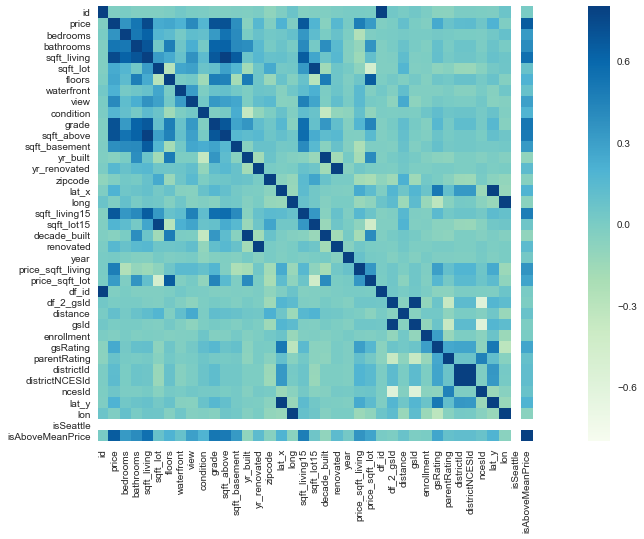

In [86]:
#Display correlation matrix as heatmap
sns.heatmap(df_corr, vmax=.8, square=True, cmap="GnBu")

In [22]:
df3.describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,enrollment,gsRating,parentRating,districtId,districtNCESId,ncesId,lat_y,lon,isSeattle,isAboveMeanPrice
count,19201.00,19201.00,19201.00,19201.00,19201.00,19201.00,19201.00,19201.00,19201.00,19201.00,...,19201.00,19201.00,19201.00,19201.00,19201.00,19201.00,19201.00,19201.00,19201.00,19201.00
mean,4551659531.09,547315.07,3.38,2.12,2099.27,14662.49,1.49,0.01,0.24,3.42,...,572.81,7.29,3.90,160.35,5305330.62,528006026554.74,47.56,-122.22,0.35,0.37
std,2865080484.02,367874.48,0.90,0.77,918.21,39611.22,0.53,0.08,0.77,0.65,...,297.38,2.70,0.85,74.50,2583.58,36872844891.24,0.14,0.13,0.48,0.48
min,1000102.00,75000.00,0.00,0.00,290.00,520.00,1.00,0.00,0.00,1.00,...,0.00,1.00,0.00,1.00,5300001.00,0.00,47.19,-122.45,0.00,0.00
25%,2117700085.00,325000.00,3.00,1.75,1440.00,5100.00,1.00,0.00,0.00,3.00,...,402.00,5.00,4.00,113.00,5303750.00,530375001495.00,47.47,-122.32,0.00,0.00
50%,3897100060.00,457000.00,3.00,2.25,1940.00,7620.00,1.50,0.00,0.00,3.00,...,517.00,8.00,4.00,147.00,5304980.00,530456002566.00,47.57,-122.23,0.00,0.00
75%,7287100135.00,652100.00,4.00,2.50,2570.00,10631.00,2.00,0.00,0.00,4.00,...,650.00,10.00,4.00,229.00,5307710.00,530771001219.00,47.68,-122.13,1.00,1.00
max,9900000190.00,6885000.00,10.00,8.00,13540.00,1651359.00,3.50,1.00,4.00,5.00,...,2186.00,10.00,5.00,279.00,5309300.00,590004700125.00,47.77,-121.81,1.00,1.00


# Feature Selection with Random Forest & Cross Validation

In [23]:
predictors = [
    'bedrooms','bathrooms','sqft_living','sqft_lot','floors','waterfront','view','condition','grade','sqft_above',
    'sqft_basement','yr_built','renovated','gsRating'
]

X = df3[predictors]
y = df3['isAboveMeanPrice']

In [24]:
model = RandomForestClassifier(n_estimators = 45)
    
model.fit(X, y)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_split=1e-07, min_samples_leaf=1,
            min_samples_split=2, min_weight_fraction_leaf=0.0,
            n_estimators=45, n_jobs=1, oob_score=False, random_state=None,
            verbose=0, warm_start=False)

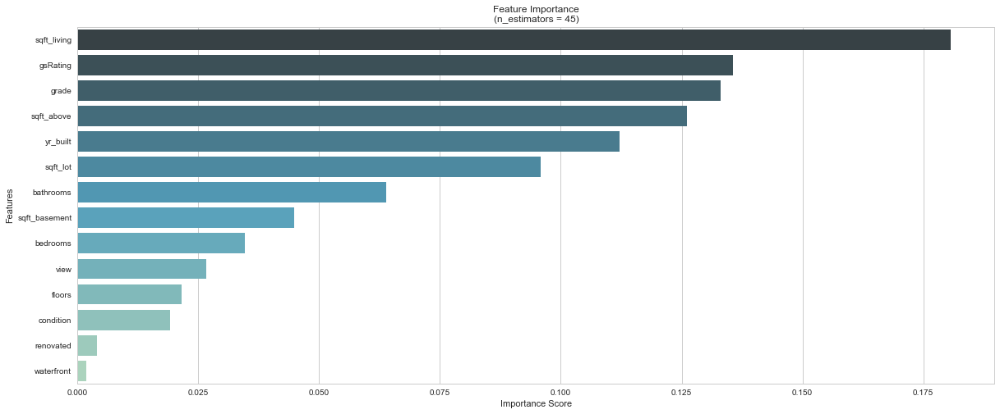

In [25]:
features = predictors
feature_importances = model.feature_importances_

features_df = pd.DataFrame({'Features': features, 'Importance Score': feature_importances})
features_df.sort_values('Importance Score', inplace=True, ascending=False)
features_df.reset_index(inplace=True)

ax = sns.barplot(x="Importance Score", y="Features", data=features_df,palette="GnBu_d")
ax.set(xlabel='Importance Score', ylabel='Features',title='Feature Importance\n(n_estimators = 45)')
plt.show()

### Cross Validation

In [26]:
model = RandomForestClassifier(n_estimators=45)
scores = cross_validation.cross_val_score(model, X, y, cv=6, scoring='roc_auc')

print 'Average AUC %f' % scores.mean()

Average AUC 0.913405


### Feature Analysis

In [27]:
#limit features to top 5 based on importance score
feature_cols = features_df['Features'][:5]

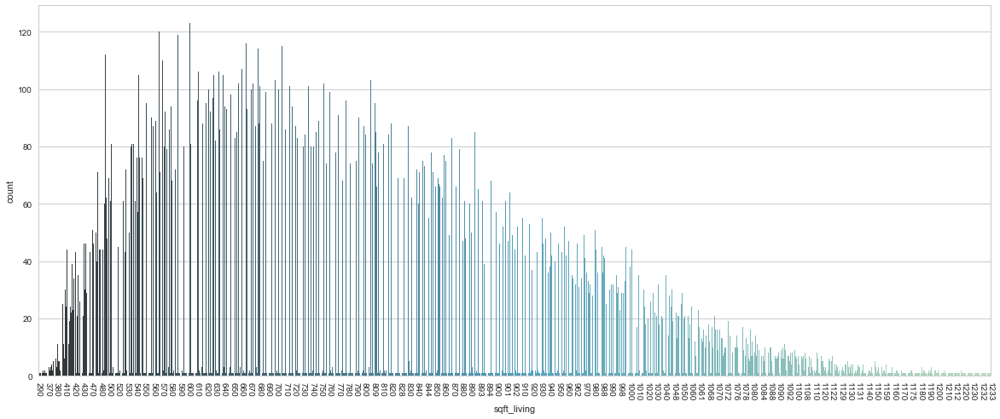

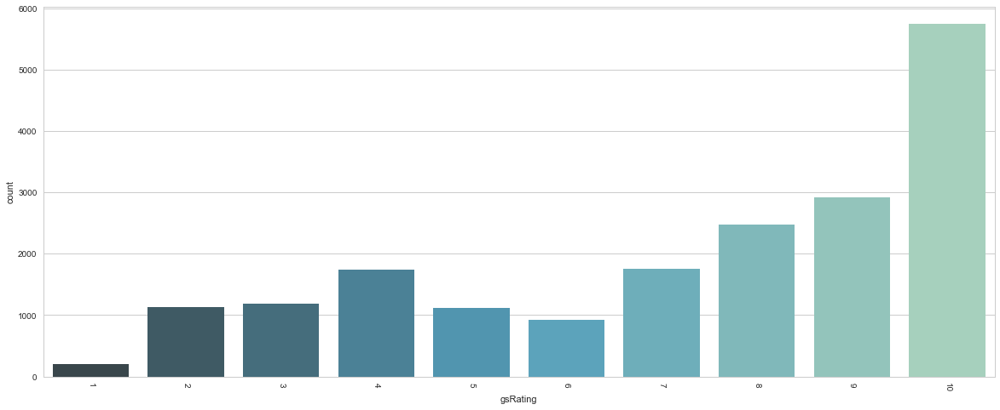

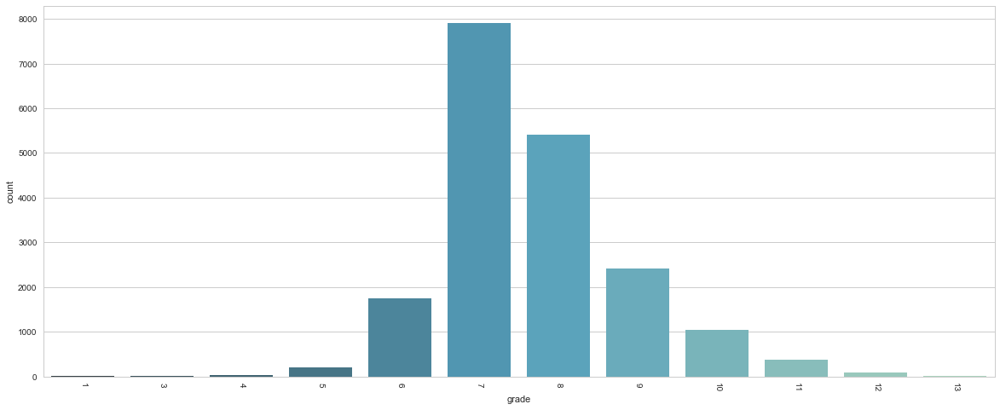

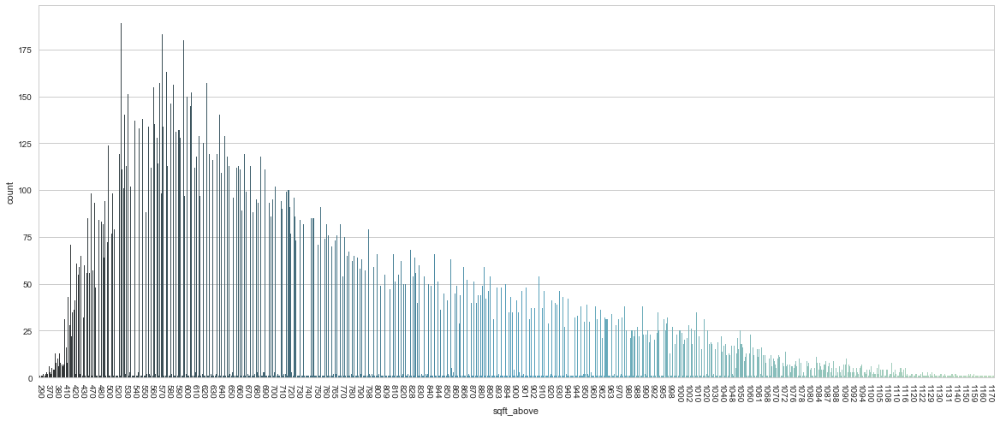

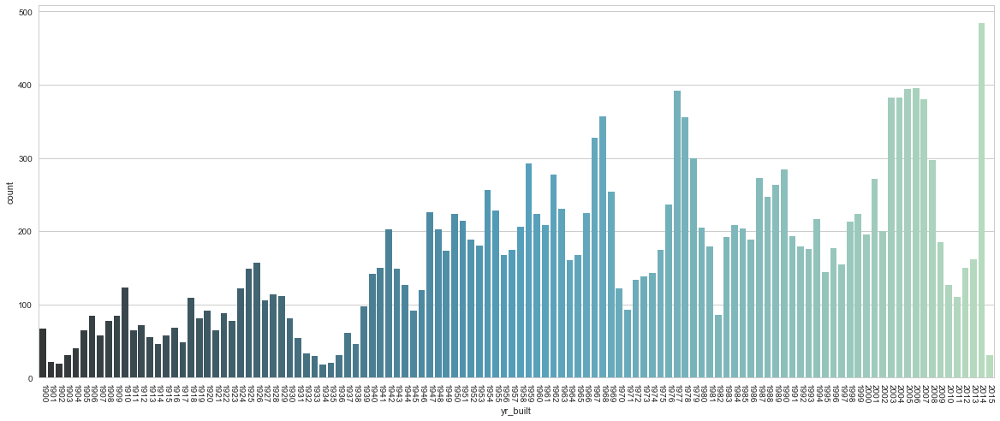

In [29]:
for i, col in enumerate(feature_cols):
    plt.figure(i)
    plt.xticks(rotation=-90)
    sns.countplot(x=col, data=df3,palette='GnBu_d')
    plt.locator_params(axis='x', nbins=115)

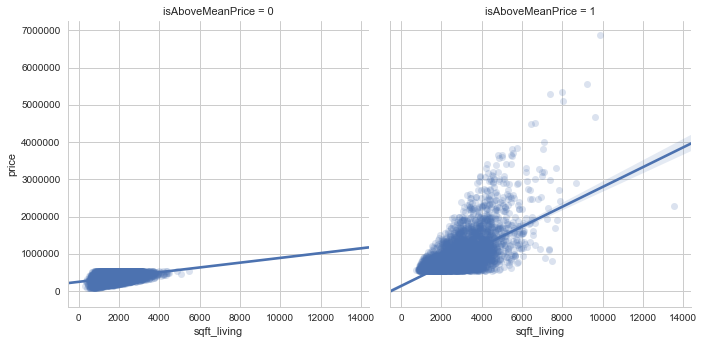

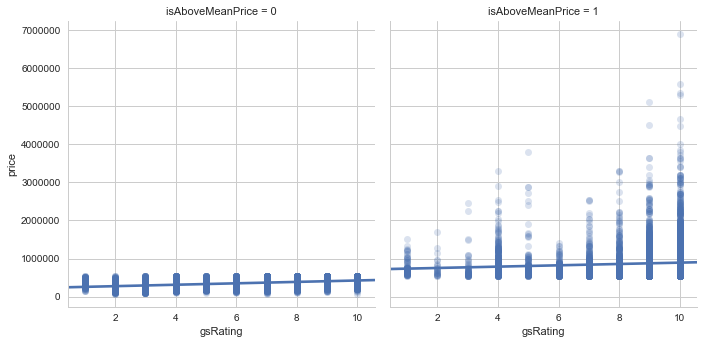

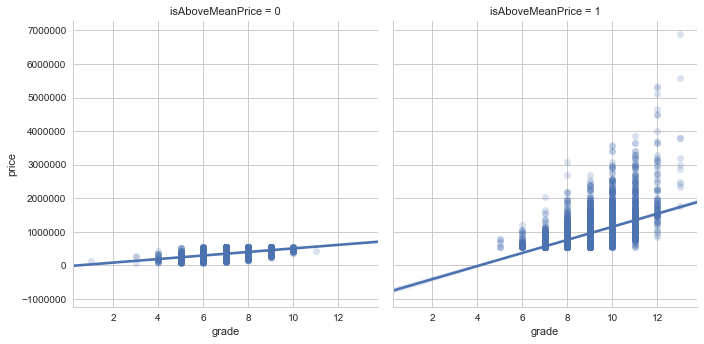

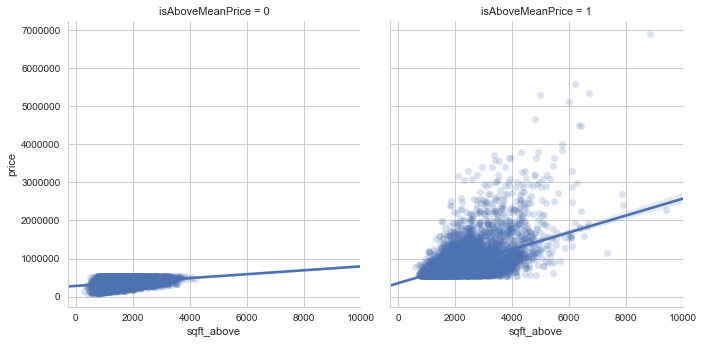

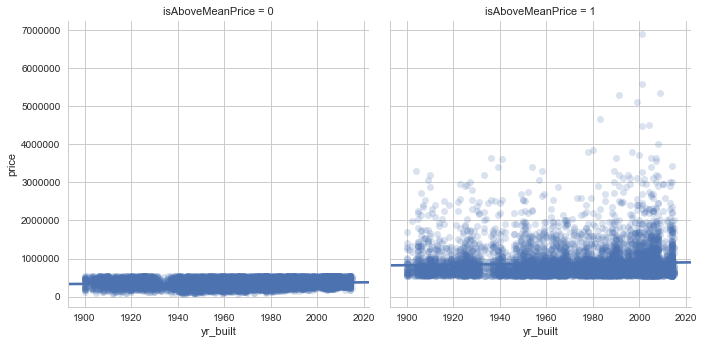

In [30]:
for i, col in enumerate(feature_cols):
    plt.figure(i)
    sns.lmplot(x=col,y="price", data=df3,col="isAboveMeanPrice",palette='GnBu_d',scatter_kws={'alpha':0.2})

### Linear Regression

/Users/sfox/anaconda2/lib/python2.7/site-packages/scipy/linalg/basic.py:1018: RuntimeWarning:

internal gelsd driver lwork query error, required iwork dimension not returned. This is likely the result of LAPACK bug 0038, fixed in LAPACK 3.2.2 (released July 21, 2010). Falling back to 'gelss' driver.



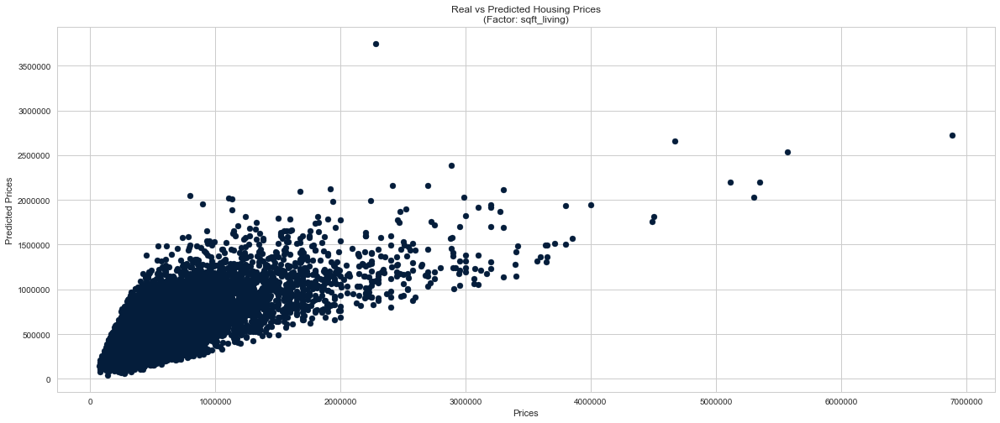

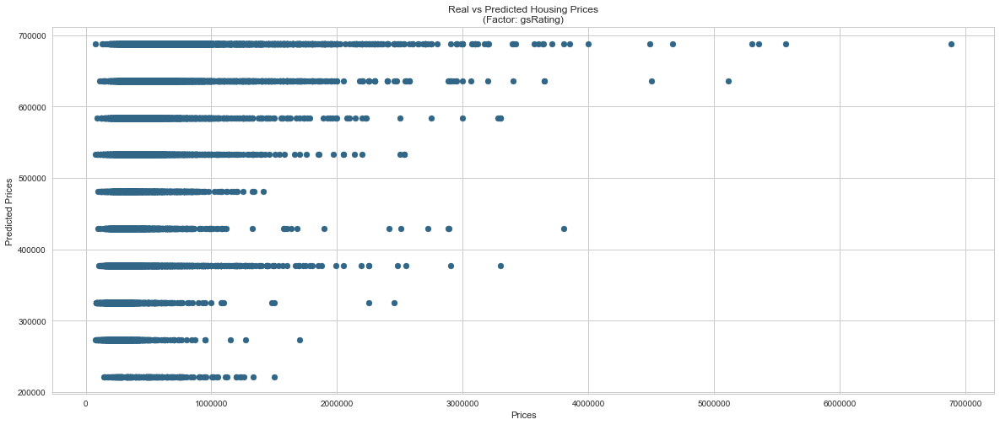

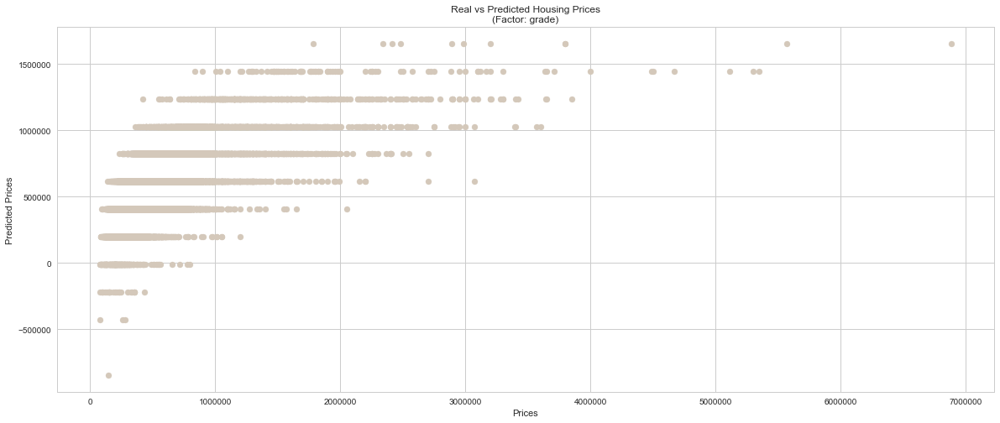

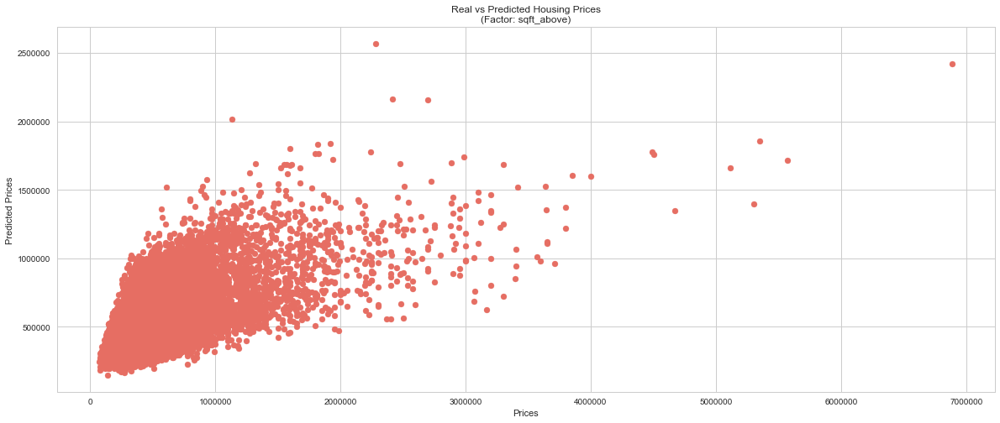

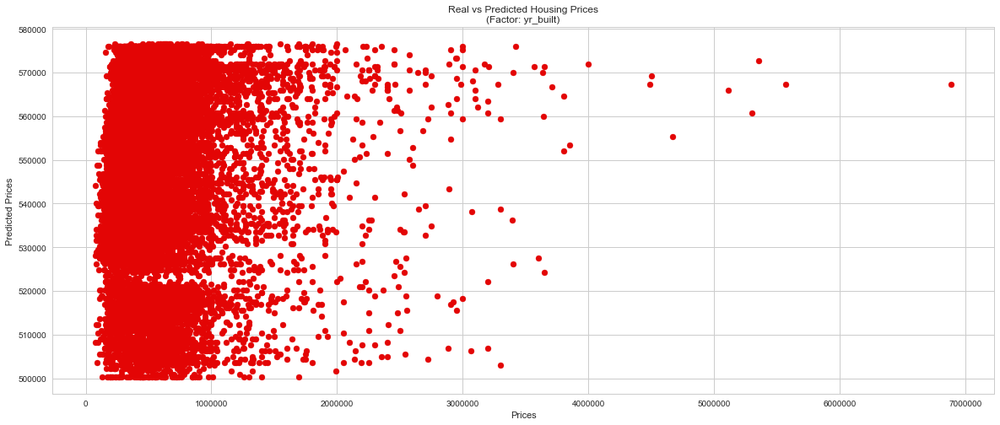

In [31]:
for i, col in enumerate(feature_cols):
    
    colors = ["#041d3b","#316687","#d4c8ba","#e66e63","#e30505"]
    X = np.array([df3[col]]).T
    y = np.array([df3['price']]).T
    
    LinMod = LinearRegression()
    LinMod.fit(X,y)
    
    plt.figure(i)
    plt.scatter( df3.price, LinMod.predict(X), c=colors[i])

    plt.xlabel( "Prices")
    plt.ylabel( "Predicted Prices")
    plt.title( "Real vs Predicted Housing Prices\n(Factor: "+col+")")

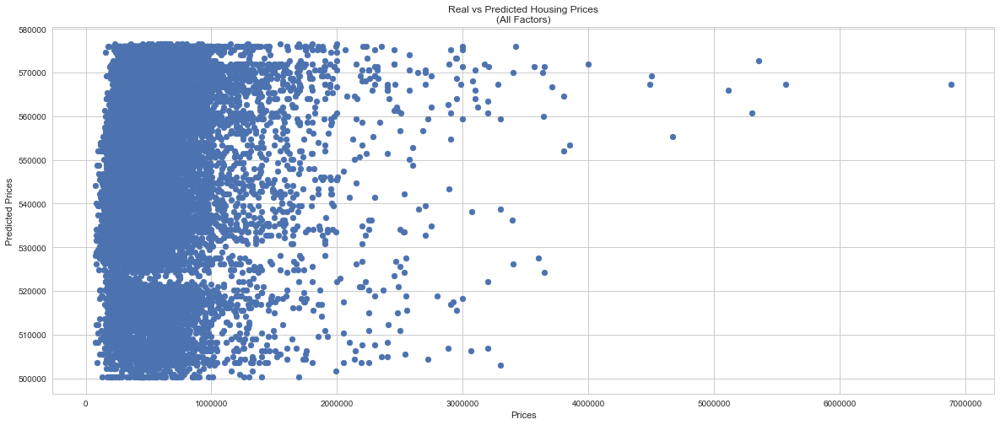

In [32]:
#All factors
plt.scatter( df3.price, LinMod.predict(X))
plt.xlabel( "Prices")
plt.ylabel( "Predicted Prices")
plt.title( "Real vs Predicted Housing Prices\n(All Factors)")

### OLS Regression

In [33]:
lm = smf.ols(formula='price ~ sqft_living + sqft_above + grade + gsRating + yr_built', data=df3).fit()
print lm.summary()

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.634
Model:                            OLS   Adj. R-squared:                  0.634
Method:                 Least Squares   F-statistic:                     6663.
Date:                Mon, 22 May 2017   Prob (F-statistic):               0.00
Time:                        21:13:19   Log-Likelihood:            -2.6365e+05
No. Observations:               19201   AIC:                         5.273e+05
Df Residuals:                   19195   BIC:                         5.274e+05
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
Intercept    6.047e+06   1.21e+05     49.790      

### Dataset Creation for Visualizations

In [34]:
priceStats = df3.groupby('date').agg({'price':['mean','std']}).reset_index()

upper_bound = go.Scatter(
    name='Upper Bound',
    x=priceStats['date'],
    y=priceStats.price['mean']+priceStats.price['std'],
    mode='lines',
    marker=dict(color="444"),
    line=dict(width=0),
    fillcolor='rgba(68, 68, 68, 0.3)',
    fill='tonexty' )

trace = go.Scatter(
    name='Mean',
    x=priceStats['date'],
    y=priceStats.price['mean'],
    mode='lines',
    line=dict(color='rgb(31, 119, 180)'),
    fillcolor='rgba(68, 68, 68, 0.3)',
    fill='tonexty' )

lower_bound = go.Scatter(
    name='Lower Bound',
    x=priceStats['date'],
    y=priceStats.price['mean']-priceStats.price['std'],
    marker=dict(color="444"),
    line=dict(width=0),
    mode='lines')

data = [lower_bound, trace, upper_bound]

layout = go.Layout(
    yaxis=dict(autotick=False,dtick=250000,title='Home Sale Price'),
    xaxis=dict(title='Transaction Date'),
    title='Average Home Sale Price, King County (WA) <br> Duration: 5/2014 - 5/2015',
    showlegend = False)
fig0 = go.Figure(data=data, layout=layout)

In [48]:
priceStatsByDecade = df3[['decade_built','zipcode','price','sqft_lot','sqft_living']]
priceStatsByDecade_1900 = priceStatsByDecade[priceStatsByDecade['decade_built'] == 1900]
priceStatsByDecade_1910 = priceStatsByDecade[priceStatsByDecade['decade_built'] == 1910]
priceStatsByDecade_1920 = priceStatsByDecade[priceStatsByDecade['decade_built'] == 1920]
priceStatsByDecade_1930 = priceStatsByDecade[priceStatsByDecade['decade_built'] == 1930]
priceStatsByDecade_1940 = priceStatsByDecade[priceStatsByDecade['decade_built'] == 1940]
priceStatsByDecade_1950 = priceStatsByDecade[priceStatsByDecade['decade_built'] == 1950]
priceStatsByDecade_1960 = priceStatsByDecade[priceStatsByDecade['decade_built'] == 1960]
priceStatsByDecade_1970 = priceStatsByDecade[priceStatsByDecade['decade_built'] == 1970]
priceStatsByDecade_1980 = priceStatsByDecade[priceStatsByDecade['decade_built'] == 1980]
priceStatsByDecade_1990 = priceStatsByDecade[priceStatsByDecade['decade_built'] == 1990]
priceStatsByDecade_2000 = priceStatsByDecade[priceStatsByDecade['decade_built'] == 2000]
priceStatsByDecade_2010 = priceStatsByDecade[priceStatsByDecade['decade_built'] == 2010]

In [49]:
trace0 = go.Scatter(
    x = priceStatsByDecade_1900['sqft_living'],
    y = priceStatsByDecade_1900['price'],
    name = '1900',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgb(171, 171, 171)',
        line = dict(
            width = 1
        )
    )
)

trace1 = go.Scatter(
    x = priceStatsByDecade_1910['sqft_living'],
    y = priceStatsByDecade_1910['price'],
    name = '1910',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgb(174, 117, 117)',
        line = dict(
            width = 1
        )
    )
)

trace2 = go.Scatter(
    x = priceStatsByDecade_1920['sqft_living'],
    y = priceStatsByDecade_1920['price'],
    name = '1920',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgb(179, 0, 0)',
        line = dict(
            width = 1
        )
    )
)

trace3 = go.Scatter(
    x = priceStatsByDecade_1930['sqft_living'],
    y = priceStatsByDecade_1930['price'],
    name = '1930',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgb(56, 0, 250)',
        line = dict(
            width = 1
        )
    )
)

trace4 = go.Scatter(
    x = priceStatsByDecade_1940['sqft_living'],
    y = priceStatsByDecade_1940['price'],
    name = '1940',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgb(52, 148, 52)',
        line = dict(
            width = 1
        )
    )
)

trace5 = go.Scatter(
    x = priceStatsByDecade_1950['sqft_living'],
    y = priceStatsByDecade_1950['price'],
    name = '1950',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgb(39, 111, 111)',
        line = dict(
            width = 1
        )
    )
)

trace6 = go.Scatter(
    x = priceStatsByDecade_1960['sqft_living'],
    y = priceStatsByDecade_1960['price'],
    name = '1960',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgb(220, 219, 66)',
        line = dict(
            width = 1
        )
    )
)

trace7 = go.Scatter(
    x = priceStatsByDecade_1970['sqft_living'],
    y = priceStatsByDecade_1970['price'],
    name = '1970',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgb(229, 173, 0)',
        line = dict(
            width = 1
        )
    )
)

trace8 = go.Scatter(
    x = priceStatsByDecade_1980['sqft_living'],
    y = priceStatsByDecade_1980['price'],
    name = '1980',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgb(229, 88, 0)',
        line = dict(
            width = 1
        )
    )
)

trace9 = go.Scatter(
    x = priceStatsByDecade_1990['sqft_living'],
    y = priceStatsByDecade_1990['price'],
    name = '1990',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgb(189, 171, 171)',
        line = dict(
            width = 1
        )
    )
)

trace10 = go.Scatter(
    x = priceStatsByDecade_2000['sqft_living'],
    y = priceStatsByDecade_2000['price'],
    name = '2000',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgb(81, 0, 74)',
        line = dict(
            width = 1
        )
    )
)

trace11 = go.Scatter(
    x = priceStatsByDecade_2010['sqft_living'],
    y = priceStatsByDecade_2010['price'],
    name = '2010',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgb(0, 111, 111)',
        line = dict(
            width = 1
        )
    )
)

data = [trace0, trace1,trace2,trace3,trace4,trace5,trace6,trace7,trace8,trace9,trace10,trace11]

layout = dict(
              yaxis = dict(autotick=False,dtick=250000,title='Home Sale Price'),
              xaxis = dict(autotick=False,dtick=1000,title='Living Space (Sqft)'),
              title = 'Correlation of Living Space (Sqft) to Home Sale Price, King County (WA) <br> Color-Coded By Decade',
             )

fig1 = dict(data=data, layout=layout)

In [50]:
trace0 = go.Scatter(
    x = priceStatsByDecade_1900['sqft_lot'],
    y = priceStatsByDecade_1900['price'],
    name = '1900',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgb(171, 171, 171)',
        line = dict(
            width = 1
        )
    )
)

trace1 = go.Scatter(
    x = priceStatsByDecade_1910['sqft_lot'],
    y = priceStatsByDecade_1910['price'],
    name = '1910',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgb(174, 117, 117)',
        line = dict(
            width = 1
        )
    )
)

trace2 = go.Scatter(
    x = priceStatsByDecade_1920['sqft_lot'],
    y = priceStatsByDecade_1920['price'],
    name = '1920',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgb(179, 0, 0)',
        line = dict(
            width = 1
        )
    )
)

trace3 = go.Scatter(
    x = priceStatsByDecade_1930['sqft_lot'],
    y = priceStatsByDecade_1930['price'],
    name = '1930',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgb(56, 0, 250)',
        line = dict(
            width = 1
        )
    )
)

trace4 = go.Scatter(
    x = priceStatsByDecade_1940['sqft_lot'],
    y = priceStatsByDecade_1940['price'],
    name = '1940',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgb(52, 148, 52)',
        line = dict(
            width = 1
        )
    )
)

trace5 = go.Scatter(
    x = priceStatsByDecade_1950['sqft_lot'],
    y = priceStatsByDecade_1950['price'],
    name = '1950',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgb(39, 111, 111)',
        line = dict(
            width = 1
        )
    )
)

trace6 = go.Scatter(
    x = priceStatsByDecade_1960['sqft_lot'],
    y = priceStatsByDecade_1960['price'],
    name = '1960',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgb(220, 219, 66)',
        line = dict(
            width = 1
        )
    )
)

trace7 = go.Scatter(
    x = priceStatsByDecade_1970['sqft_lot'],
    y = priceStatsByDecade_1970['price'],
    name = '1970',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgb(229, 173, 0)',
        line = dict(
            width = 1
        )
    )
)

trace8 = go.Scatter(
    x = priceStatsByDecade_1980['sqft_lot'],
    y = priceStatsByDecade_1980['price'],
    name = '1980',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgb(229, 88, 0)',
        line = dict(
            width = 1
        )
    )
)

trace9 = go.Scatter(
    x = priceStatsByDecade_1990['sqft_lot'],
    y = priceStatsByDecade_1990['price'],
    name = '1990',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgb(189, 171, 171)',
        line = dict(
            width = 1
        )
    )
)

trace10 = go.Scatter(
    x = priceStatsByDecade_2000['sqft_lot'],
    y = priceStatsByDecade_2000['price'],
    name = '2000',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgb(81, 0, 74)',
        line = dict(
            width = 1
        )
    )
)

trace11 = go.Scatter(
    x = priceStatsByDecade_2010['sqft_lot'],
    y = priceStatsByDecade_2010['price'],
    name = '2010',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgb(0, 111, 111)',
        line = dict(
            width = 1
        )
    )
)

data = [trace0, trace1,trace2,trace3,trace4,trace5,trace6,trace7,trace8,trace9,trace10,trace11]

layout = dict(
              yaxis = dict(range=[0,8000000],autotick=False,dtick=250000,title='Home Sale Price'),
              xaxis = dict(title='Lot Space (Sqft)'),
              title = 'Correlation of Lot Space (Sqft) to Home Sale Price, King County (WA) <br> Color-Coded By Decade',
             )

fig2 = dict(data=data, layout=layout)

In [77]:
sqftPriceByDecade = df3.groupby('decade_built').agg({'price_sqft_living':'mean','price_sqft_lot':'mean'}).reset_index()
sqftPriceByDecade

trace0 = go.Scatter(
    x=sqftPriceByDecade['price_sqft_living'],
    y=sqftPriceByDecade['decade_built'],
    mode='markers',
    name='Mean Price per Sqft (living)',
    marker=dict(
        color='rgb(81, 0, 74)',
        line=dict(
            color='rgba(156, 165, 196, 1.0)',
            width=1,
        ),
        symbol='circle',
        size=16,
    )
)
trace1 = go.Scatter(
    x=sqftPriceByDecade['price_sqft_lot'],
    y=sqftPriceByDecade['decade_built'],
    mode='markers',
    name='Mean Price per Sqft (lot)',
    marker=dict(
        color='rgb(0, 111, 111)',
        line=dict(
            color='rgba(217, 217, 217, 1.0)',
            width=1,
        ),
        symbol='circle',
        size=16,
    )
)
data = [trace0, trace1]
layout = dict(
              yaxis = dict(range=[1890,2020],autotick=False,dtick=10,ticks='outside',zeroline = False,title='Decade Built'),
              xaxis = dict(autotick=False,dtick=50,ticks='outside',zeroline = False,title='Mean Price per Sqft'),
              title = 'Comparison of Mean Price per Sqft (lot) Versus Mean Price per Sqft (living), King County (WA) <br> Color-Coded By Sqft Classification',
             )

fig3 = go.Figure(data=data, layout=layout)

In [52]:
homeImprovementSqft = df3[['waterfront','renovated','view','price_sqft_lot','price_sqft_living']]

trace0 = go.Box(
    y=homeImprovementSqft['price_sqft_living'],
    x=homeImprovementSqft['waterfront'],
    name='Price Per Sqft (living)',
    marker=dict(
        color='rgb(81, 0, 74)'
    )
)

trace1 = go.Box(
    y=homeImprovementSqft['price_sqft_lot'],
    x=homeImprovementSqft['waterfront'],
    name='Price Per Sqft (lot)',
    marker=dict(
        color='rgb(0, 111, 111)'
    )
)


data = [trace0,trace1]

layout = go.Layout(
    xaxis=dict(
        title='Is Waterfront Property<br>(0 = False, 1 = True)'
    ),
    yaxis=dict(
        range=[0,2100],
        autotick=False,dtick=100,ticks='outside',
        title='Price Per Sqft'
    ),
    boxmode='group',
    title = 'Box Plot Comparison of Waterfront versus Non-Waterfront Properties, King County (WA) <br> Color-Coded By Sqft Classification',

)
fig4 = go.Figure(data=data, layout=layout)

In [53]:
trace0 = go.Box(
    y=homeImprovementSqft['price_sqft_living'],
    x=homeImprovementSqft['renovated'],
    name='Price Per Sqft (living)',
    marker=dict(
        color='rgb(81, 0, 74)'
    )
)

trace1 = go.Box(
    y=homeImprovementSqft['price_sqft_lot'],
    x=homeImprovementSqft['renovated'],
    name='Price Per Sqft (lot)',
    marker=dict(
        color='rgb(0, 111, 111)'
    )
)


data = [trace0,trace1]

layout = go.Layout(
    xaxis=dict(
        title='Is Renovated Property<br>(0 = False, 1 = True)'
    ),
    yaxis=dict(
        range=[0,2200],
        autotick=False,dtick=100,ticks='outside',
        title='Price Per Sqft'
    ),
    boxmode='group',
    title = 'Box Plot Comparison of Renovated Properties versus Non-Renovated Properties, King County (WA) <br> Color-Coded By Sqft Classification',

)
fig5 = go.Figure(data=data, layout=layout)

In [54]:
trace0 = go.Histogram(
    x=df3['bathrooms'],
    marker=dict(
    color='rgb(0, 111, 111)'
    )
)

data=[trace0]

layout = go.Layout(
    xaxis=dict(
        title='Number of Bathrooms'
    ),
    title='Distribution of Bathrooms, King County (WA)'
)
fig6 = go.Figure(data=data, layout=layout)

In [55]:
trace0 = go.Histogram(
    x=df3['bathrooms'],histnorm='probability',
    marker=dict(
    color='rgb(0, 111, 111)'
    )

)

data=[trace0]

layout = go.Layout(
    xaxis=dict(
        title='Number of Bathrooms'
    ),
    title='Normalized Distribution of Bathrooms, King County (WA)'
)
fig7 = go.Figure(data=data, layout=layout)

In [56]:
trace0 = go.Histogram(
    x=df3['bedrooms'],
    marker=dict(
    color='rgb(81, 0, 74)'
    )
)

data=[trace0]

layout = go.Layout(
    xaxis=dict(
        title='Number of Bedrooms'
    ),
    title='Distribution of Bedrooms, King County (WA)'
)
fig8 = go.Figure(data=data, layout=layout)

In [57]:
trace0 = go.Histogram(
    x=df3['bedrooms'],
    histnorm='probability',
    marker=dict(
    color='rgb(81, 0, 74)'
    )
)

data=[trace0]

layout = go.Layout(
    xaxis=dict(
        title='Number of Bedrooms'
    ),
    title='Normalized Distribution of Bedrooms, King County (WA)'
)
fig9 = go.Figure(data=data, layout=layout)

In [58]:
lats = list(df3.lat_x)
lons = list(df3.long)
x = df3.price.values #returns a numpy array
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
df_price = pd.DataFrame(x_scaled)
prices = list(df_price[0])


data = Data([
    Scattermapbox(
        lat=lats,
        lon=lons,
        mode='markers',
        marker=Marker(
            size=9,
            color=prices,
            colorscale='Picnic',
            showscale=True
        ),
        text=prices,
    )
])
layout = Layout(
    autosize=False,
    width = 1200,
    height = 800,
    hovermode='closest',
    mapbox=dict(
        accesstoken=mapbox_access_token,
        bearing=0,
        center=dict(
            lat=47.6062,
            lon=-122.3321
        ),
        pitch=0,
        zoom=8
    ),
    title='Home Sales by Location, King County (WA)<br>Color Coded by Normalized Home Price'
)

fig10a = dict(data=data, layout=layout)

/Users/sfox/anaconda2/lib/python2.7/site-packages/sklearn/utils/validation.py:429: DataConversionWarning:

Data with input dtype int64 was converted to float64 by MinMaxScaler.

/Users/sfox/anaconda2/lib/python2.7/site-packages/sklearn/preprocessing/data.py:321: DeprecationWarning:

Passing 1d arrays as data is deprecated in 0.17 and will raise ValueError in 0.19. Reshape your data either using X.reshape(-1, 1) if your data has a single feature or X.reshape(1, -1) if it contains a single sample.

/Users/sfox/anaconda2/lib/python2.7/site-packages/sklearn/preprocessing/data.py:356: DeprecationWarning:

Passing 1d arrays as data is deprecated in 0.17 and will raise ValueError in 0.19. Reshape your data either using X.reshape(-1, 1) if your data has a single feature or X.reshape(1, -1) if it contains a single sample.



In [59]:
lats = list(df3.lat_x)
lons = list(df3.long)
sqfts_living = list(df3.sqft_living)


data = Data([
    Scattermapbox(
        lat=lats,
        lon=lons,
        mode='markers',
        marker=Marker(
            size=9,
            color=sqfts_living,
            colorscale='Picnic',
            showscale=True
        ),
        text=sqfts_living,
    )
])
layout = Layout(
    autosize=False,
    width = 1200,
    height = 800,
    hovermode='closest',
    mapbox=dict(
        accesstoken=mapbox_access_token,
        bearing=0,
        center=dict(
            lat=47.6062,
            lon=-122.3321
        ),
        pitch=0,
        zoom=8
    ),
    title='Home Sales by Location, King County (WA)<br>Color Coded by Sqft Living'
)

fig10b = dict(data=data, layout=layout)

In [60]:
lats = list(df3.lat_x)
lons = list(df3.long)
gsRatings = list(df3.gsRating)


data = Data([
    Scattermapbox(
        lat=lats,
        lon=lons,
        mode='markers',
        marker=Marker(
            size=9,
            color=gsRatings,
            colorscale='Picnic',
            showscale=True
        ),
        text=gsRatings,
    )
])
layout = Layout(
    autosize=False,
    width = 1200,
    height = 800,
    hovermode='closest',
    mapbox=dict(
        accesstoken=mapbox_access_token,
        bearing=0,
        center=dict(
            lat=47.6062,
            lon=-122.3321
        ),
        pitch=0,
        zoom=8
    ),
    title='Home Sales by Location, King County (WA)<br>Color Coded by GreatSchools Rating'
)

fig10c = dict(data=data, layout=layout)

In [61]:
df3 = df3[df3['isSeattle'] == 1]
lats = list(df3.lat_x)
lons = list(df3.long)
x = df3.price.values
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
df_price = pd.DataFrame(x_scaled)
prices = list(df_price[0])


data = Data([
    Scattermapbox(
        lat=lats,
        lon=lons,
        mode='markers',
        marker=Marker(
            size=9,
            color=prices,
            colorscale='Portland',
            showscale=True
        ),
        text=prices,
    )
])
layout = Layout(
    autosize=False,
    width = 1200,
    height = 800,
    hovermode='closest',
    mapbox=dict(
        accesstoken=mapbox_access_token,
        bearing=0,
        center=dict(
            lat=47.6062,
            lon=-122.3321
        ),
        pitch=0,
        zoom=10
    ),
    title='Home Sales by Location, Seattle, WA<br>Color Coded by Normalized Home Price'
)

fig11a = dict(data=data, layout=layout)

/Users/sfox/anaconda2/lib/python2.7/site-packages/sklearn/preprocessing/data.py:321: DeprecationWarning:

Passing 1d arrays as data is deprecated in 0.17 and will raise ValueError in 0.19. Reshape your data either using X.reshape(-1, 1) if your data has a single feature or X.reshape(1, -1) if it contains a single sample.

/Users/sfox/anaconda2/lib/python2.7/site-packages/sklearn/preprocessing/data.py:356: DeprecationWarning:

Passing 1d arrays as data is deprecated in 0.17 and will raise ValueError in 0.19. Reshape your data either using X.reshape(-1, 1) if your data has a single feature or X.reshape(1, -1) if it contains a single sample.



In [76]:
lats = list(df3.lat_x)
lons = list(df3.long)
sqfts_living = list(df3.sqft_living)

data = Data([
    Scattermapbox(
        lat=lats,
        lon=lons,
        mode='markers',
        marker=Marker(
            size=9,
            color=sqfts_living,
            colorscale='Portland',
            showscale=True
        ),
        text=sqfts_living,
    )
])
layout = Layout(
    autosize=False,
    width = 1200,
    height = 800,
    hovermode='closest',
    mapbox=dict(
        accesstoken=mapbox_access_token,
        bearing=0,
        center=dict(
            lat=47.6062,
            lon=-122.3321
        ),
        pitch=0,
        zoom=10
    ),
    title='Home Sales by Location, Seattle, WA<br>Color Coded by Sqft Living'
)

fig11b = dict(data=data, layout=layout)

In [63]:
df3 = df3[df3['isSeattle'] == 1]
lats = list(df3.lat_x)
lons = list(df3.long)
gsRatings = list(df3.gsRating)

data = Data([
    Scattermapbox(
        lat=lats,
        lon=lons,
        mode='markers',
        marker=Marker(
            size=9,
            color=gsRatings,
            colorscale='Portland',
            showscale=True
        ),
        text=gsRatings,
    )
])
layout = Layout(
    autosize=False,
    width = 1200,
    height = 800,
    hovermode='closest',
    mapbox=dict(
        accesstoken=mapbox_access_token,
        bearing=0,
        center=dict(
            lat=47.6062,
            lon=-122.3321
        ),
        pitch=0,
        zoom=10
    ),
    title='Home Sales by Location, Seattle, WA<br>Color Coded by GreatSchools Rating'
)

fig11b = dict(data=data, layout=layout)

**VI. Visualization Generation**

In [64]:
py.iplot(fig0)

In [65]:
py.iplot(fig1)

In [66]:
py.iplot(fig2)

In [67]:
py.iplot(fig3)

In [68]:
py.iplot(fig4)

In [69]:
py.iplot(fig5)

In [70]:
py.iplot(fig6)

In [71]:
py.iplot(fig7)

In [72]:
py.iplot(fig8)

In [74]:
py.iplot(fig9)

In [75]:
py.iplot(fig10a)
#offline.plot(fig10a) #save visualization locally

In [23]:
py.iplot(fig10b)
#offline.plot(fig10b) #save visualization locally

'file:///Users/sfox/Documents/GADataScience/Homework/FinalProject/JupyterNotebooks/temp-plot.html'

In [24]:
py.iplot(fig10c)
#offline.plot(fig10c) #save visualization locally

'file:///Users/sfox/Documents/GADataScience/Homework/FinalProject/JupyterNotebooks/temp-plot.html'

In [127]:
py.iplot(fig11a)
#offline.plot(fig11a) #save visualization locally

'file:///Users/sfox/Documents/GADataScience/Homework/FinalProject/JupyterNotebooks/temp-plot.html'

In [128]:
py.iplot(fig11b)
#offline.plot(fig11b) #save visualization locally

'file:///Users/sfox/Documents/GADataScience/Homework/FinalProject/JupyterNotebooks/temp-plot.html'

In [129]:
py.iplot(fig11c)
#offline.plot(fig11c) #save visualization locally

'file:///Users/sfox/Documents/GADataScience/Homework/FinalProject/JupyterNotebooks/temp-plot.html'